# Визуализация.

Датасет представляет собой коллекцию медицинских и демографических данных пациентов, а также их статус диабета (положительный или отрицательный). Данные включают такие характеристики, как возраст, пол, индекс массы тела (ИМТ), гипертония, сердечно-сосудистые заболевания, история курения, уровень HbA1c и уровень глюкозы в крови. 

В будущем этот датасет может быть использован для построения моделей машинного обучения для прогнозирования диабета у пациентов на основе их истории болезни и демографической информации. Это может быть полезно для медицинских работников при выявлении пациентов, которые могут быть подвержены риску развития диабета, и при разработке персонализированных планов лечения.

Описание столбцов:

|Название| Описание |
|--|--|
|`gender`| Пол пациента |
|`age`| Возраст |
|`hypertension`| Гипертония —  это состояние, при котором кровяное давление в артериях постоянно повышено. Он принимает значения 0 или 1, где 0 означает отсутствие гипертонии, а 1 —  наличие гипертонии. |
|`heart_disease`| Болезни сердца —  это еще одно состояние, которое связано с повышенным риском развития диабета. Он также принимает значения 0 или 1, где 0 означает отсутствие сердечных заболеваний, а 1 —  наличие сердечных заболеваний. |
|`smoking_history`| Опыт курения —  также считается фактором риска развития диабета и может усугубить осложнения, связанные с диабетом. | 
|`bmi`| Это показатель количества жира в организме, основанный на весе и росте. Более высокие значения ИМТ связаны с повышенным риском развития диабета. Диапазон ИМТ в наборе данных составляет от 10,16 до 71,55. ИМТ менее 18,5 —  это недостаточный вес, 18,5-24,9 —  нормальный, 25-29,9 —  избыточный вес, а 30 и более —  ожирение. |
|`HbA1c_level`| Уровень HbA1c (гемоглобин A1c) —  это показатель среднего уровня сахара в крови человека за последние 2-3 месяца. Более высокий уровень указывает на больший риск развития диабета. В основном более 6,5% уровня HbA1c указывает на диабет. | 
|`blood_glucose_level`| Уровень глюкозы в крови —  это количество глюкозы в крови в определенный момент времени. Высокий уровень глюкозы в крови является основным признаком диабета. |
|`diabetes`| Диабет является целевой переменной (таргетом), при этом значение 1 указывает на наличие диабета, а 0 —  на его отсутствие. |

## Задание

Проведите визуализацию данных и попробуйте выяснить причины, от чего и с чем связаны основные причины наличия диабета у людей.

Ваша цель —  визуально с помощью графиков определить и доказать, что при наличии какого-либо фактора возможен риск развития диабета.

Этапы выполнения задания (наш pipeline):

1. Загрузка и предобработка данных (при необходимости)
2. Описательный анализ данных, просмотр данных
3. Построение гистограмм числовых переменных
4. Построение диаграмм размаха для определения наличия выбросов (ящики с усами) числовых переменных
5. Построение столбчатых диаграмм для категориальных переменных
6. Построение матрицы корреляции признаков (Phik или Пирсона)
7. Сравнение двух выборок
8. Общий вывод

## Загрузка данных

In [1]:
### импортируйте нужные библиотеки 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [2]:
df = pd.read_csv('./diabetes_prediction_dataset.csv')

In [3]:
# ваш код здесь
df

,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
0,Female,80.0,0,1,never,25.19,6.6,140,0
1,Female,54.0,0,0,No Info,27.32,6.6,80,0
2,Male,28.0,0,0,never,27.32,5.7,158,0
3,Female,36.0,0,0,current,23.45,5.0,155,0
4,Male,76.0,1,1,current,20.14,4.8,155,0
...,...,...,...,...,...,...,...,...,...
99995,Female,80.0,0,0,No Info,27.32,6.2,90,0
99996,Female,2.0,0,0,No Info,17.37,6.5,100,0
99997,Male,66.0,0,0,former,27.83,5.7,155,0
99998,Female,24.0,0,0,never,35.42,4.0,100,0


## Описательный анализ данных

Рассмотрите данные —  изучите медианы, средние, дисперсии и т.д. 

Что можете сказать о данных? Сделайте вывод.

In [4]:
# ваш код здесь
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 9 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   gender               100000 non-null  object 
 1   age                  100000 non-null  float64
 2   hypertension         100000 non-null  int64  
 3   heart_disease        100000 non-null  int64  
 4   smoking_history      100000 non-null  object 
 5   bmi                  100000 non-null  float64
 6   HbA1c_level          100000 non-null  float64
 7   blood_glucose_level  100000 non-null  int64  
 8   diabetes             100000 non-null  int64  
dtypes: float64(3), int64(4), object(2)
memory usage: 6.9+ MB


In [5]:
df.isna().sum()

gender                 0
age                    0
hypertension           0
heart_disease          0
smoking_history        0
bmi                    0
HbA1c_level            0
blood_glucose_level    0
diabetes               0
dtype: int64

array([[<Axes: title={'center': 'age'}>,
        <Axes: title={'center': 'hypertension'}>,
        <Axes: title={'center': 'heart_disease'}>],
       [<Axes: title={'center': 'bmi'}>,
        <Axes: title={'center': 'HbA1c_level'}>,
        <Axes: title={'center': 'blood_glucose_level'}>],
       [<Axes: title={'center': 'diabetes'}>, <Axes: >, <Axes: >]],
      dtype=object)

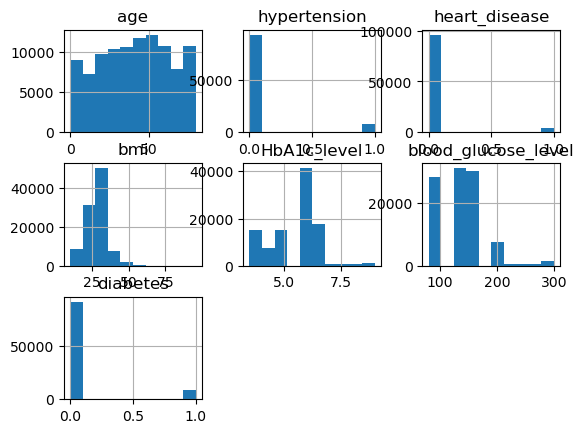

In [6]:
df.hist()

In [7]:
df.describe().round()

,age,hypertension,heart_disease,bmi,HbA1c_level,blood_glucose_level,diabetes
count,100000.0,100000.0,100000.0,100000.0,100000.0,100000.0,100000.0
mean,42.0,0.0,0.0,27.0,6.0,138.0,0.0
std,23.0,0.0,0.0,7.0,1.0,41.0,0.0
min,0.0,0.0,0.0,10.0,4.0,80.0,0.0
25%,24.0,0.0,0.0,24.0,5.0,100.0,0.0
50%,43.0,0.0,0.0,27.0,6.0,140.0,0.0
75%,60.0,0.0,0.0,30.0,6.0,159.0,0.0
max,80.0,1.0,1.0,96.0,9.0,300.0,1.0


In [8]:
df.mode(numeric_only=True)

,age,hypertension,heart_disease,bmi,HbA1c_level,blood_glucose_level,diabetes
0,80.0,0,0,27.32,6.6,130,0


In [9]:
df.var(numeric_only=True)

age                     507.008078
hypertension              0.069248
heart_disease             0.037866
bmi                      44.046894
HbA1c_level               1.146339
blood_glucose_level    1657.152341
diabetes                  0.077776
dtype: float64

In [10]:
fig = px.histogram(df, x='gender', color='diabetes', barmode='group', height=400)
fig.show()

In [11]:
df.gender.value_counts()

Female    58552
Male      41430
Other        18
Name: gender, dtype: int64

In [12]:
df.gender[df.diabetes == 1].value_counts()

Female    4461
Male      4039
Name: gender, dtype: int64

In [13]:
pr_pain_w = (4461 * 100) / 58552 # процент больных женьщин из датасета
pr_pain_h = (4039 * 100) / 41430 # процент больных мужчин из датасета

In [14]:
round(pr_pain_w, 1)

7.6

In [15]:
round(pr_pain_h, 1)

9.7

**Вывод:** 
1) В датасете никаких пропусков нет
2) По хистограмме видно, что нормального распредления нет
3) В среднем возраст пациентов, проходящих тестирование по подозрению на диабет - люди в районе 40 лет
4) Из всех данных около 7,6 процентов женщин страдаю деабетом, среди мужчин это число равно 9.7 процентов
5) Так называемые ДРУГИЕ... Никто из них не страдает диабетом.

## Предобработка данных

### Дубликаты

Предобработайте датасет —  проверьте на наличие дубликатов и удалите, если они есть.

In [16]:
# ваш код здесь
df.drop_duplicates(inplace=True)

### Отсутствующие значения

Предобработайте датасет — проверьте на наличие NaN и удалите или заполните значения.

In [17]:
# ваш код здесь
df.isna().sum()

gender                 0
age                    0
hypertension           0
heart_disease          0
smoking_history        0
bmi                    0
HbA1c_level            0
blood_glucose_level    0
diabetes               0
dtype: int64

In [18]:
fig = px.histogram(df, x='gender', color='smoking_history', barmode='group', height=400)
fig.show()

### Изменение типа данных

Рассмотрев все данные, замените типы на нужные (при необходимости):

- Если есть числа — на `int` или `float`
- Если категории — можно оставить `object`

In [19]:
# ваш код здесь

In [20]:
df

,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
0,Female,80.0,0,1,never,25.19,6.6,140,0
1,Female,54.0,0,0,No Info,27.32,6.6,80,0
2,Male,28.0,0,0,never,27.32,5.7,158,0
3,Female,36.0,0,0,current,23.45,5.0,155,0
4,Male,76.0,1,1,current,20.14,4.8,155,0
...,...,...,...,...,...,...,...,...,...
99994,Female,36.0,0,0,No Info,24.60,4.8,145,0
99996,Female,2.0,0,0,No Info,17.37,6.5,100,0
99997,Male,66.0,0,0,former,27.83,5.7,155,0
99998,Female,24.0,0,0,never,35.42,4.0,100,0


**Вывод:**
Дубликатов нет, все заменено)

## Визуализация

Построим графики:

1. Построение гистограмм числовых переменных
2. Построение диаграмм размаха для определения наличия выбросов (ящики с усами) числовых переменных
3. Построение столбчатых диаграмм для категориальных переменных
4. Построение матрицы корреляции признаков (Phik или Пирсона)

После построения опишите выборку. Что она из себя представляет? Есть ли зависимости?

# ваш код здесь...
# 1. Построение гистограмм числовых переменных

array([[<Axes: title={'center': 'age'}>,
        <Axes: title={'center': 'hypertension'}>,
        <Axes: title={'center': 'heart_disease'}>],
       [<Axes: title={'center': 'bmi'}>,
        <Axes: title={'center': 'HbA1c_level'}>,
        <Axes: title={'center': 'blood_glucose_level'}>],
       [<Axes: title={'center': 'diabetes'}>, <Axes: >, <Axes: >]],
      dtype=object)

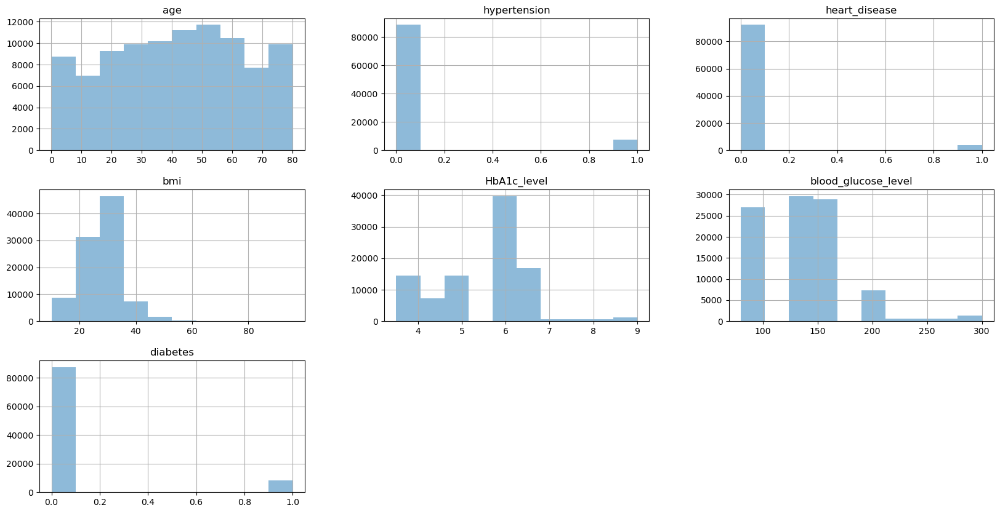

In [21]:
df.hist(alpha=0.5, figsize=(20, 10))

# 2. Построение диаграмм размаха для определения наличия выбросов (ящики с усами) числовых переменных

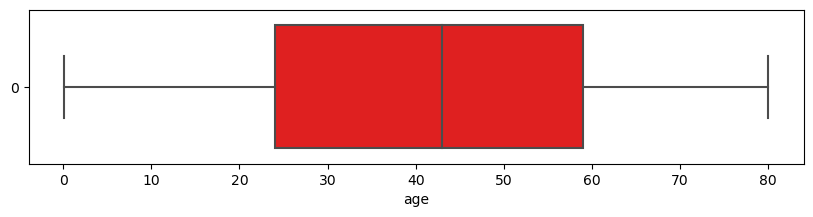

In [22]:
plt.figure(figsize=(10,2))
sns.boxplot(df.age, orient='h', color='red')
plt.xlabel('age')
plt.show()

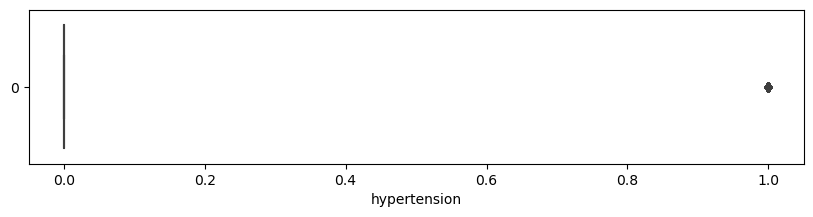

In [23]:
plt.figure(figsize=(10,2))
sns.boxplot(df.hypertension, orient='h')
plt.xlabel('hypertension')
plt.show()

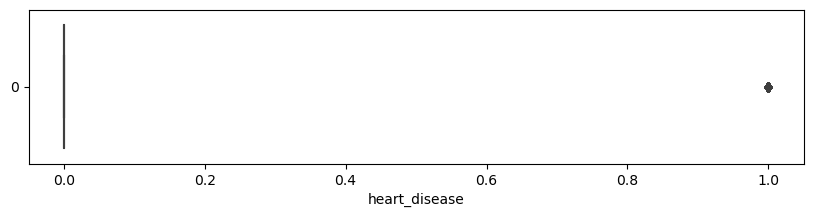

In [24]:
plt.figure(figsize=(10,2))
sns.boxplot(df.heart_disease, orient='h')
plt.xlabel('heart_disease')
plt.show()

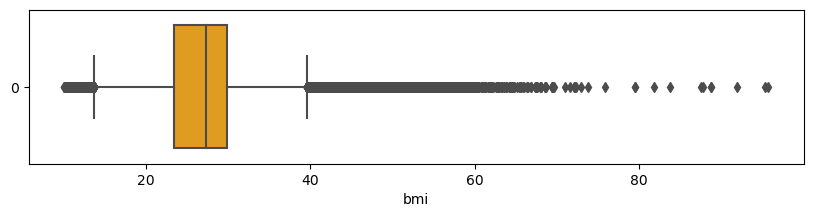

In [25]:
plt.figure(figsize=(10,2))
sns.boxplot(df.bmi, orient='h', color='orange')
plt.xlabel('bmi')
plt.show()

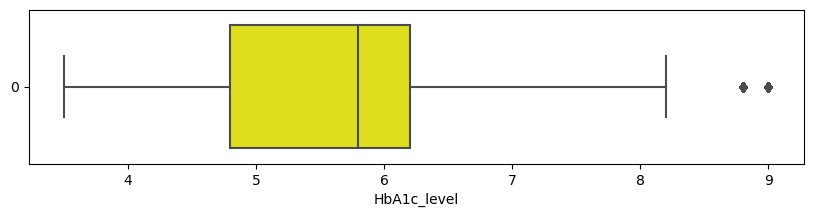

In [26]:
plt.figure(figsize=(10,2))
sns.boxplot(df.HbA1c_level, orient='h', color='yellow')
plt.xlabel('HbA1c_level')
plt.show()

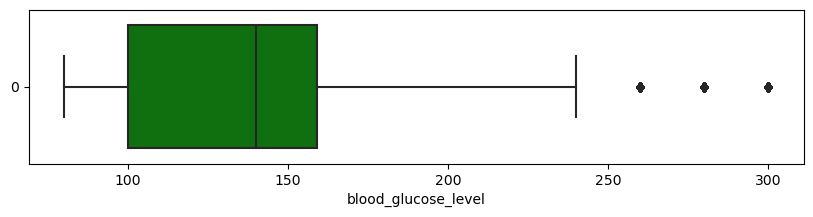

In [27]:
plt.figure(figsize=(10,2))
sns.boxplot(df.blood_glucose_level, orient='h', color='green')
plt.xlabel('blood_glucose_level')
plt.show()

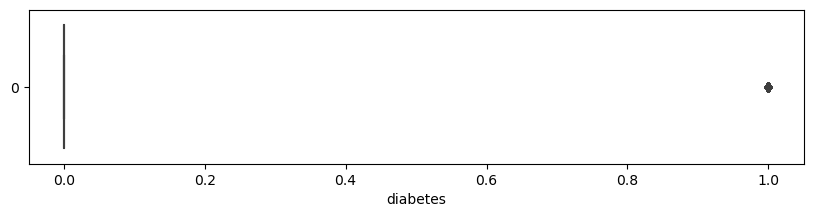

In [28]:
plt.figure(figsize=(10,2))
sns.boxplot(df.diabetes, orient='h')
plt.xlabel('diabetes')
plt.show()

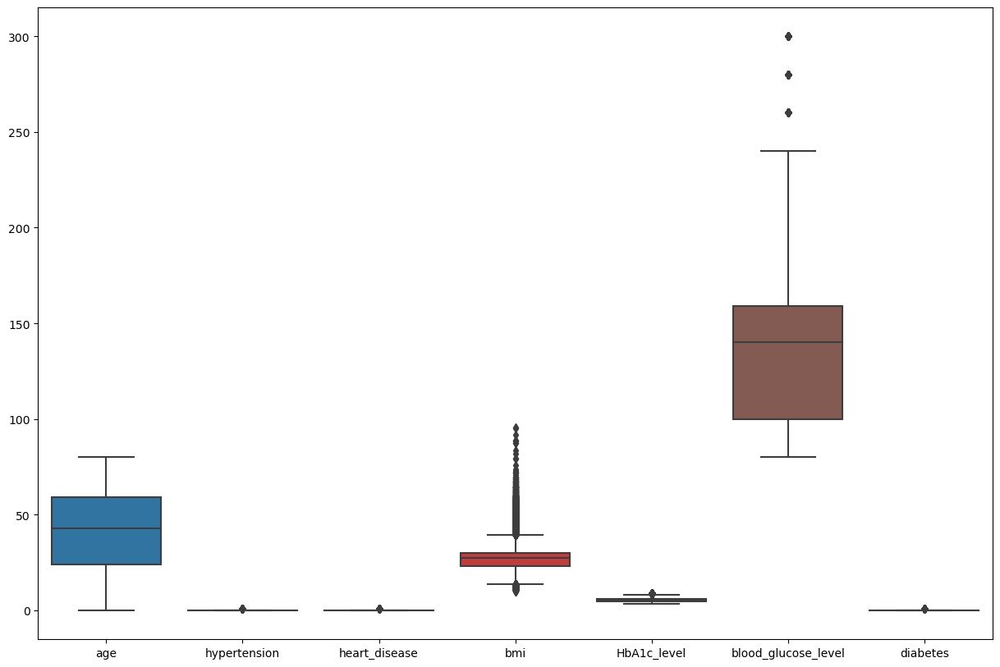

In [29]:
plt.figure(figsize=(15, 10))
sns.boxplot(df);

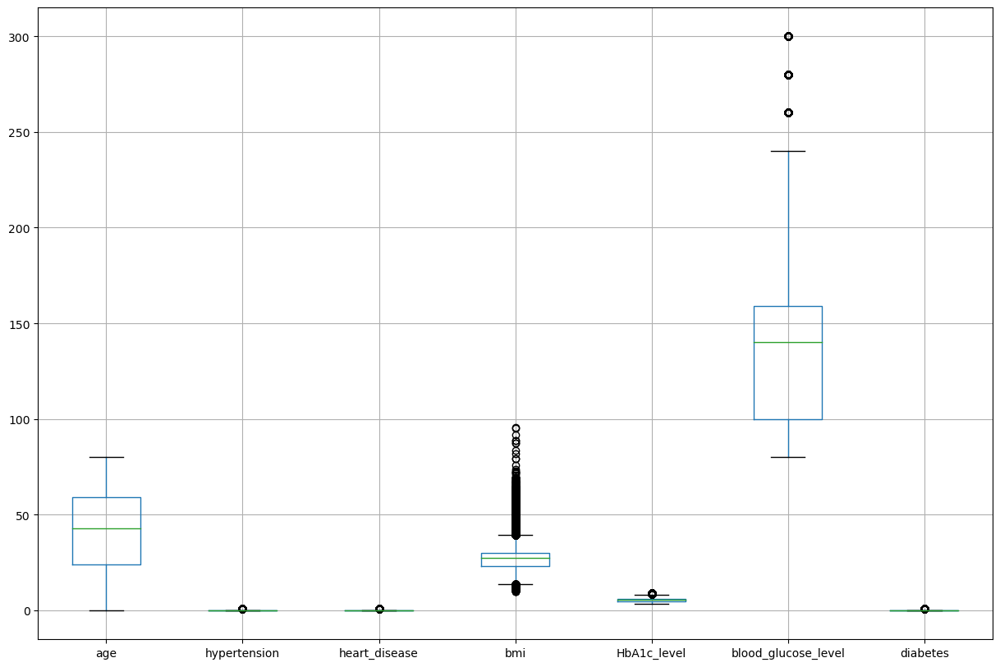

In [30]:
df.boxplot(figsize=(15, 10));

# Вопрос: Можно ли бы сделать все КРАСИВЫЕ усатые графики на одной картинке, если да то как?)

# 3. Построение столбчатых диаграмм для категориальных переменных

In [31]:
fig = px.histogram(df, x='gender', color='smoking_history', barmode='group', height=400, title="История курения по полу")
fig.show()

In [32]:
fig = px.histogram(df, x='smoking_history', 
                   color='gender', 
                   barmode='group', 
                   height=400, 
                   title="История курения по полу(наоборот)")
fig.show()

# 4. Построение матрицы корреляции признаков (Phik или Пирсона)

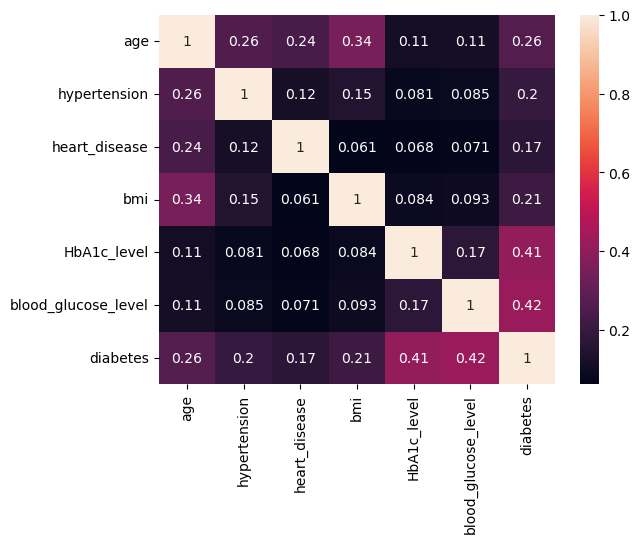

In [33]:
ax = sns.heatmap(df.corr(numeric_only=True), annot=True)

In [34]:
# df['gender'] = pd.factorize(df['gender'])[0] # 0 - Female, 1 - Male
# df['smoking_history'] = pd.factorize(df['smoking_history'])[0] # # 0 - never, 1 - No Info, 2 - current

**Вывод:** 
1) Как сказанно ранее, нигде нет нормального распределения 
2) Выбросы есть на колонках, кроме возраста
3) В целом большиство либо не курило, либо не дает четкого ответа
4) Хорошо между собой коррелируют значения возраста и с факторами, сопуствующим диабету и сам диабет, но эти факторы плохо коррелируют между собой по отдельности

## Сравнение выборок

После построения всех типов графиков, необходимо провести анализ:

Отобразите на одном графике две выборки — люди с диабетом и без и сравните их.

1. Для числовых признаков — гистограммы и ящики с усами.
2. Для категориальных — столбчатые диаграммы.

После напишите вывод, есть ли какая-то зависимость?

In [35]:
# ваш код здесь
di_y = df[df.diabetes == 1] # есть диабет
di_n = df[df.diabetes == 0] # нет диабета

# Информация о тех пациентах, у кого был найдет диабет

array([[<Axes: title={'center': 'age'}>,
        <Axes: title={'center': 'hypertension'}>,
        <Axes: title={'center': 'heart_disease'}>],
       [<Axes: title={'center': 'bmi'}>,
        <Axes: title={'center': 'HbA1c_level'}>,
        <Axes: title={'center': 'blood_glucose_level'}>],
       [<Axes: title={'center': 'diabetes'}>, <Axes: >, <Axes: >]],
      dtype=object)

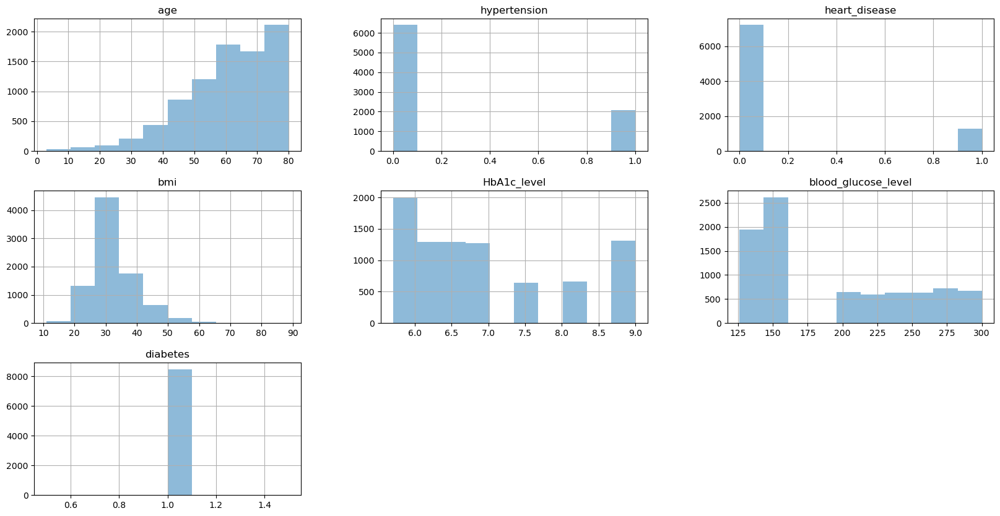

In [36]:
di_y.hist(alpha=0.5, figsize=(20, 10))

In [37]:
fig = px.box(di_y, x="gender", y="age", color="gender", title='Усы по возрасту')
fig.show()

In [38]:
fig = px.box(di_y, x="gender", y="bmi", color="gender", title='Усы по ожирению')
fig.show()

In [39]:
fig = px.box(di_y, x="gender", y="HbA1c_level", color="gender", title='Усы по уровню сахара')
fig.show()

In [40]:
fig = px.box(di_y, x="gender", y="blood_glucose_level", color="gender", title='Усы по количеству глюкозы в крови')
fig.show()

# Информация о тех пациентах, у кого не был найдет диабет

array([[<Axes: title={'center': 'age'}>,
        <Axes: title={'center': 'hypertension'}>,
        <Axes: title={'center': 'heart_disease'}>],
       [<Axes: title={'center': 'bmi'}>,
        <Axes: title={'center': 'HbA1c_level'}>,
        <Axes: title={'center': 'blood_glucose_level'}>],
       [<Axes: title={'center': 'diabetes'}>, <Axes: >, <Axes: >]],
      dtype=object)

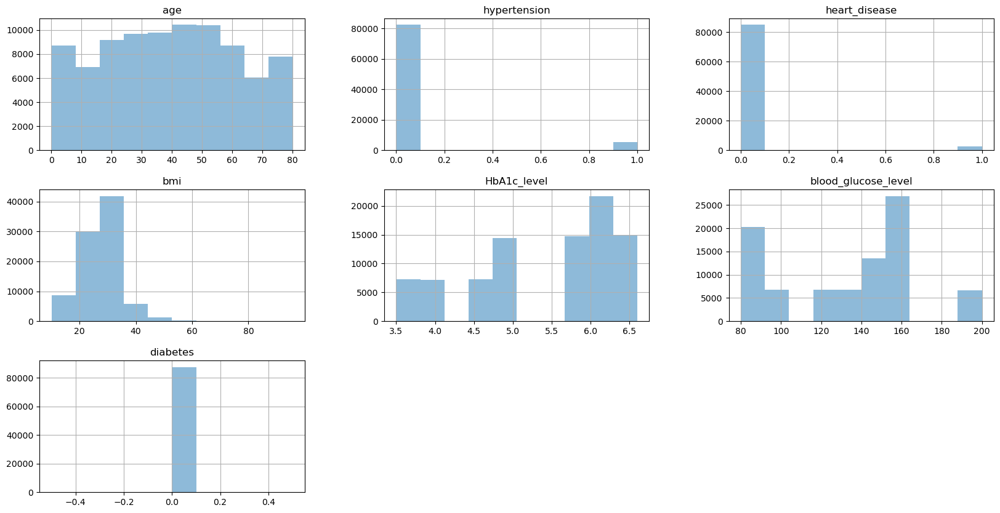

In [41]:
di_n.hist(alpha=0.5, figsize=(20, 10))

In [42]:
fig = px.box(di_n, x="gender", y="age", color="gender", title='Усы по возрасту')
fig.show()

In [43]:
fig = px.box(di_n, x="gender", y="bmi", color="gender", title='Усы по ожирению')
fig.show()

In [44]:
fig = px.box(di_n, x="gender", y="HbA1c_level", color="gender", title='Усы по уровню сахара')
fig.show()

In [45]:
fig = px.box(di_n, x="gender", y="blood_glucose_level", color="gender", title='Усы по количеству глюкозы в крови')
fig.show()

**Вывод:** 
Наболее интересным мне показалось следующее...
1) В гистограмме возраста с увеличением роста пациентов палномерно возрастает и возраст больных
2) У больных зачастую повышенный сахар
3) У больных зачастую более высокий показтель возраста

## ЗАДАЧИ PRO

Мы провели базовый анализ выше и сделали выводы.

Но даёт ли этот результат полную картину? Наша цель — узнать, каков риск возникновения диабета у пациента.

Ваша задача — воспользоваться ранее приобретенными навыками и дополнить общий вывод. 

**Этапы:**

1) Разделите выборки и постройте дополнительные графики. Может стоит разделить на несколько выборок и сравнить графики там?
2) Постройте `pairplot` с параметром `hue=='diabetes'`. Может там тоже где-то кроется истина?
3) Постройте тепловую карту корреляции `Phik` и сделайте дополнительный вывод.
4) Дополните общий вывод. 

**Примечание:** задание не ограничено только этими этапами. Можно их дополнить — может стоит сделать фильтр данных, рассмотреть данные под другим углом и провести дополнительную аналитику? Средствами и методами не ограничены.

# 1. Разделите выборки и постройте дополнительные графики. Может стоит разделить на несколько выборок и сравнить графики там?
1) В гистограмме возраста с увеличением роста пациентов палномерно возрастает и возраст больных
2) У больных зачастую повышенный сахар
3) У больных зачастую более высокий показтель возраста


# 2) Постройте `pairplot` с параметром `hue=='diabetes'`. Может там тоже где-то кроется истина?

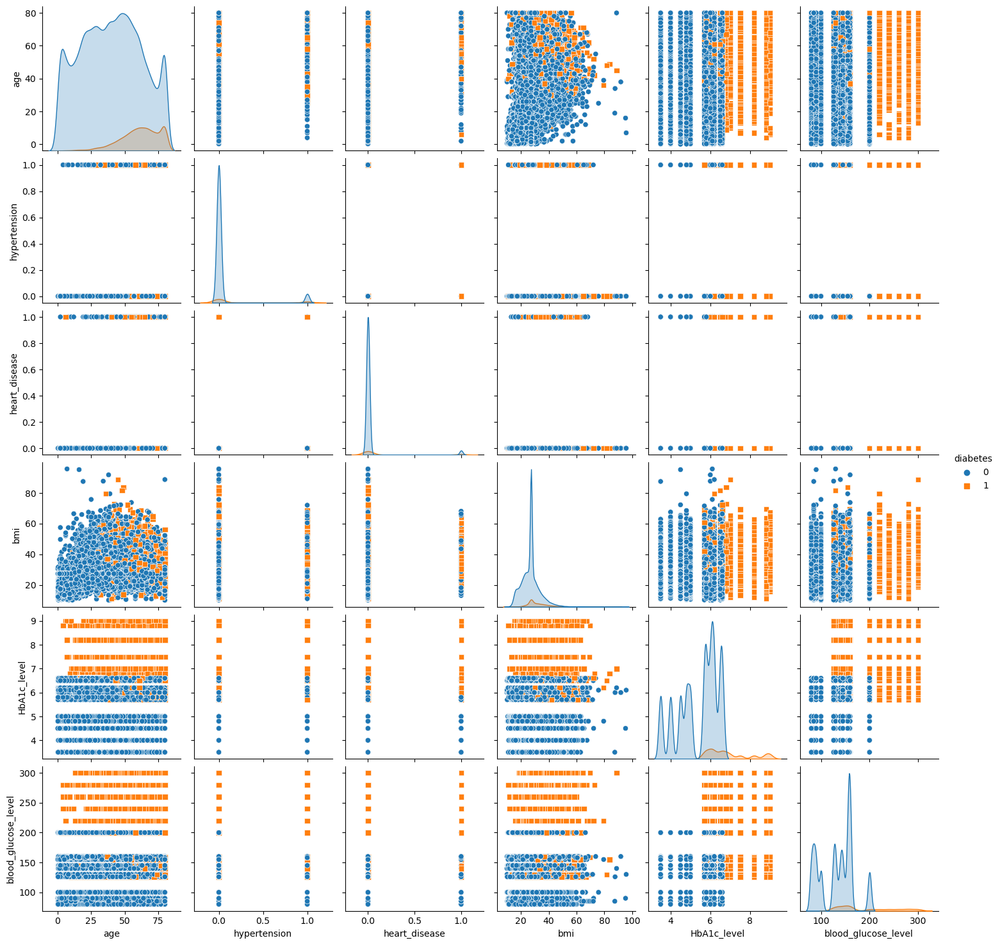

In [46]:
ax = sns.pairplot(df, hue ='diabetes', markers=["o", "s"])

# 3) Постройте тепловую карту корреляции `Phik` и сделайте дополнительный вывод.

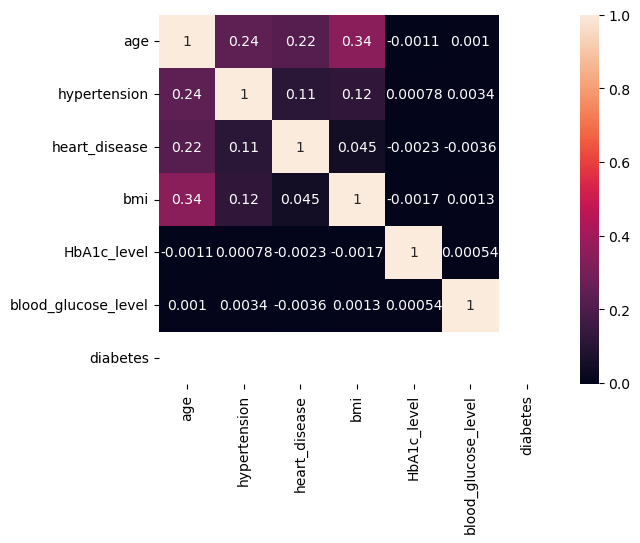

In [47]:
ax = sns.heatmap(di_n.corr(numeric_only=True), annot=True)

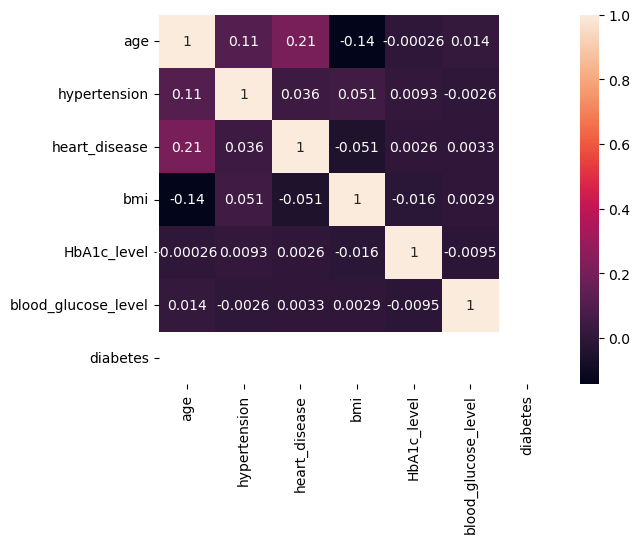

In [48]:
ax = sns.heatmap(di_y.corr(numeric_only=True), annot=True)

# Общий вывод
1) Про pairplot мне сложно что-то сказать(Если можно, разъясните)
2) наши значения, из выборок разбитых по диабету, дает понять, что наши признаки еще сильнее стали коррелировать с возрастом
Вопрос: как постороить Phik без diabetes?